In [ ]:
import ee
ee.Authenticate()
ee.Initialize()

from pathlib import Path
import pandas as pd
from folium.plugins import HeatMap
import folium
import geopandas as gpd
import time
import datetime
from shapely.geometry import shape, Point
import geopandas as gpd
import json

# Explanation here : https://medium.com/google-earth/more-accurate-and-flexible-cloud-masking-for-sentinel-2-images-766897a9ba5f


def get_image_collection(aoi, start_date, end_date, DATASET):
    # Import and filter S2 SR.
    s2_sr_col = (ee.ImageCollection(DATASET)
        .filterBounds(aoi)
        .filterDate(start_date, end_date))
    return s2_sr_col

def get_s2_sr_cld_col(aoi, start_date, end_date, DATASET):
    # Import and filter S2 SR.
    s2_sr_col = (ee.ImageCollection(DATASET)
        .filterBounds(aoi)
        .filterDate(start_date, end_date)
        .filter(ee.Filter.lte('CLOUDY_PIXEL_PERCENTAGE', CLOUD_FILTER)))

    # Import and filter s2cloudless.
    s2_cloudless_col = (ee.ImageCollection('COPERNICUS/S2_CLOUD_PROBABILITY')
        .filterBounds(aoi)
        .filterDate(start_date, end_date))

    # Join the filtered s2cloudless collection to the SR collection by the 'system:index' property.
    return ee.ImageCollection(ee.Join.saveFirst('s2cloudless').apply(**{
        'primary': s2_sr_col,
        'secondary': s2_cloudless_col,
        'condition': ee.Filter.equals(**{
            'leftField': 'system:index',
            'rightField': 'system:index'
        })
    }))

def add_cloud_bands(img):
    # Get s2cloudless image, subset the probability band.
    cld_prb = ee.Image(img.get('s2cloudless')).select('probability')

    # Condition s2cloudless by the probability threshold value.
    is_cloud = cld_prb.gt(CLD_PRB_THRESH).rename('clouds')

    # Add the cloud probability layer and cloud mask as image bands.
    return img.addBands(ee.Image([cld_prb, is_cloud]))


def add_shadow_bands(img):
    # Identify water pixels from the SCL band.
    not_water = img.select('SCL').neq(6)

    # Identify dark NIR pixels that are not water (potential cloud shadow pixels).
    SR_BAND_SCALE = 1e4
    dark_pixels = img.select('B8').lt(NIR_DRK_THRESH*SR_BAND_SCALE).multiply(not_water).rename('dark_pixels')

    # Determine the direction to project cloud shadow from clouds (assumes UTM projection).
    shadow_azimuth = ee.Number(90).subtract(ee.Number(img.get('MEAN_SOLAR_AZIMUTH_ANGLE')));

    # Project shadows from clouds for the distance specified by the CLD_PRJ_DIST input.
    cld_proj = (img.select('clouds').directionalDistanceTransform(shadow_azimuth, CLD_PRJ_DIST*10)
        .reproject(**{'crs': img.select(0).projection(), 'scale': 100})
        .select('distance')
        .mask()
        .rename('cloud_transform'))

    # Identify the intersection of dark pixels with cloud shadow projection.
    shadows = cld_proj.multiply(dark_pixels).rename('shadows')

    # Add dark pixels, cloud projection, and identified shadows as image bands.
    return img.addBands(ee.Image([dark_pixels, cld_proj, shadows]))


def add_cld_shdw_mask(img):
    # Add cloud component bands.
    img_cloud = add_cloud_bands(img)

    # Add cloud shadow component bands.
    img_cloud_shadow = add_shadow_bands(img_cloud)

    # Combine cloud and shadow mask, set cloud and shadow as value 1, else 0.
    is_cld_shdw = img_cloud_shadow.select('clouds').add(img_cloud_shadow.select('shadows')).gt(0)

    # Remove small cloud-shadow patches and dilate remaining pixels by BUFFER input.
    # 20 m scale is for speed, and assumes clouds don't require 10 m precision.
    is_cld_shdw = (is_cld_shdw.focalMin(2).focalMax(BUFFER*2/20)
        .reproject(**{'crs': img.select([0]).projection(), 'scale': 20})
        .rename('cloudmask'))

    # Add the final cloud-shadow mask to the image.
    return img.addBands(is_cld_shdw)

def apply_cld_shdw_mask(img):
    # Subset the cloudmask band and invert it so clouds/shadow are 0, else 1.
    not_cld_shdw = img.select('cloudmask').Not()

    # Subset reflectance bands and update their masks, return the result.
    return img.select('B.*').updateMask(not_cld_shdw)


def addNDVI(image):
    # Normalized difference vegetation index (NDVI)
    ndvi = image.normalizedDifference(['B8','B4']).rename("NDVI")
    image = image.addBands(ndvi)
    return image


def addNDWI(image):
    # Normalized difference water index (NDSI)
    ndwi = image.normalizedDifference(['B3','B8']).rename("NDWI")
    image = image.addBands(ndwi)
    return image


def addNDMI(image):
    # Normalized difference water index (NDSI)
    ndmi = image.normalizedDifference(['B8','B11']).rename("NDMI")
    image = image.addBands(ndmi)
    return image


def addNDBI(image):
    # Normalized difference water index (NDSI)
    ndbi = image.normalizedDifference(['B11','B8']).rename("NDBI")
    image = image.addBands(ndbi)
    return image


def addNDSI(image):
    # Normalized difference snow index (NDSI)
    ndsi = image.normalizedDifference(['B3','B11']).rename("NDSI")
    image = image.addBands(ndsi)
    return image

# Fonctions pour ajouter les indices Landsat
def addNDVI_Landsat(image):
    ndvi = image.normalizedDifference(['SR_B5', 'SR_B4']).rename('NDVI')
    return image.addBands(ndvi)

def addNDWI_Landsat(image):
    ndwi = image.normalizedDifference(['SR_B3', 'SR_B5']).rename('NDWI')
    return image.addBands(ndwi)

def addNDBI_Landsat(image):
    ndbi = image.normalizedDifference(['SR_B6', 'SR_B5']).rename('NDBI')
    return image.addBands(ndbi)

def addNDSI_landsat(image):
    ndsi = image.normalizedDifference(['SR_B3', 'SR_B6']).rename('NDSI')
    return image.addBands(ndsi)

def addNDMI_landsat(image):
    ndmi = image.normalizedDifference(['SR_B5', 'SR_B6']).rename('NDMI')
    return image.addBands(ndmi)

def myClip(image):
    img = image.clip(LOCATION)
    return img

def export_image_to_drive(img, description, folder, name, formating, region, scale):
    task = ee.batch.Export.image.toDrive(image = img, description = description,folder= folder, \
    fileNamePrefix = name, fileFormat=formating, scale=scale, maxPixels=1e13, region=region)
    task.start()
    return task

##############################################################################

departement = 'france'
root = Path('path_to_france_geo')
dir_data = Path(root / 'data')


Successfully saved authorization token.


In [2]:
geo = gpd.read_file((dir_data / 'geo/hexagones_france.gpkg'))
from shapely.ops import unary_union
from shapely.geometry import Polygon, MultiPolygon

# Union de toutes les géométries
merged = unary_union(geo.geometry)

# Si le résultat est un MultiPolygon, on garde uniquement le plus grand
if isinstance(merged, MultiPolygon):
    largest_polygon = max(merged.geoms, key=lambda p: p.area)
else:
    largest_polygon = merged  # c'est déjà un seul polygone

# Optionnel : GeoDataFrame avec ce seul polygone
import geopandas as gpd
single_polygon_gdf = gpd.GeoDataFrame(geometry=[largest_polygon], crs=geo.crs)


CLOUD_FILTER = 30
CLD_PRB_THRESH = 50
NIR_DRK_THRESH = 0.15
CLD_PRJ_DIST = 1
BUFFER = 50


/home/caron/.local/lib/python3.10/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


<Axes: >

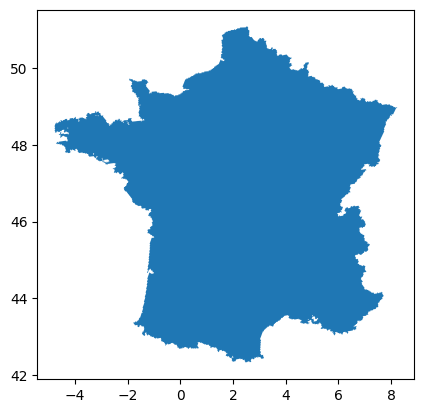

In [3]:
single_polygon_gdf.plot()

In [ ]:
import datetime
import time
import ee

# Dates et pas de temps
first_date = datetime.datetime.strptime("2017-01-01", '%Y-%m-%d')
end_date = datetime.datetime.strptime("2024-12-31", '%Y-%m-%d')
delta = datetime.timedelta(days=8)
START_DATE = datetime.datetime.strptime('2016-03-28', '%Y-%m-%d')

# Zone d'intérêt
LOCATION = ee.Geometry.Polygon(list(single_polygon_gdf['geometry'].values[0].exterior.coords))
date = first_date


# Boucle principale
while date <= end_date:
    END_DATE = date
    print(f"Traitement de {START_DATE.date()} à {END_DATE.date()}")

    region = ee.Geometry.MultiPolygon(LOCATION['coordinates'])

    # Collections Landsat 8 et 9
    l8 = ee.ImageCollection('LANDSAT/LC08/C02/T1_L2')
    l9 = ee.ImageCollection('LANDSAT/LC09/C02/T1_L2')

    imageCollection = (
        l8.merge(l9)
        .filterDate(START_DATE, END_DATE)
        .filterBounds(LOCATION)
        .map(lambda img: img.updateMask(img.select('QA_PIXEL').bitwiseAnd(1 << 3).eq(0)))  # Masque de nuages
        .map(addNDVI_Landsat)
        .map(addNDWI_Landsat)
        .map(addNDBI_Landsat)
        .map(addNDSI_landsat)
        .map(addNDMI_landsat)
    )
    
    acq_times = imageCollection.aggregate_array('system:time_start').getInfo()
    print("Dates :", [time.strftime('%x', time.gmtime(acq_time/1000)) for acq_time in acq_times])
    
    img = imageCollection.mosaic().select(['NDVI', 'NDMI', 'NDBI', 'NDSI', 'NDWI']).clip(LOCATION)

    name = date.strftime('%Y-%m-%d')
    task = export_image_to_drive(img, "", departement, name, 'GeoTIFF', region, scale=2000)

    date += delta
    time.sleep(10)

Traitement de 2016-03-28 à 2017-01-01
Dates d'acquisition : ['04/03/16', '04/19/16', '05/05/16', '05/21/16', '06/06/16', '06/22/16', '07/08/16', '07/24/16', '08/09/16', '08/25/16', '09/10/16', '09/26/16', '10/12/16', '10/28/16', '11/13/16', '11/29/16', '12/15/16', '12/31/16', '04/03/16', '04/19/16', '05/05/16', '05/21/16', '06/06/16', '06/22/16', '07/08/16', '07/24/16', '08/09/16', '08/25/16', '09/10/16', '09/26/16', '10/12/16', '10/28/16', '11/13/16', '11/29/16', '12/15/16', '12/31/16', '04/10/16', '05/28/16', '06/13/16', '06/29/16', '07/15/16', '08/16/16', '09/01/16', '09/17/16', '10/03/16', '10/19/16', '11/04/16', '11/20/16', '12/06/16', '12/22/16', '04/10/16', '05/28/16', '06/29/16', '07/15/16', '07/31/16', '08/16/16', '09/01/16', '09/17/16', '10/03/16', '10/19/16', '11/04/16', '11/20/16', '12/06/16', '12/22/16', '04/10/16', '04/26/16', '05/28/16', '06/13/16', '06/29/16', '07/15/16', '07/31/16', '08/16/16', '09/01/16', '09/17/16', '10/03/16', '10/19/16', '11/04/16', '11/20/16', '12